# Estimación Robusta de Parámetros Acústicos con KDE

### Autor: Sebastián Escobar Pajoy  
### Mediciones por: Lucía Rodriguez Giraldo
En la caracterización acústica de recintos, la **respuesta al impulso** de una sala proporciona información crítica tanto en frecuencia como en tiempo para comprender su comportamiento sonoro. A partir de ella, podemos derivar la **curva de Schroeder**, la cual sirve de base para calcular casi todas las métricas acústicas estándar (TR₆₀, EDT, C₅₀, D₅₀, etc.).

Sin embargo, obtener estimaciones precisas suele exigir:
- **Múltiples posiciones de medición** (docenas de puntos)  
- **Altavoces de ruido rosa o sine-sweep** calibrados (dodecaedros)  
- **Micrófonos de medición o sonómetros** de alto rendimiento  

Estos requisitos pueden resultar costosos y difíciles de cumplir “in situ”.  

---

## Nuestra Propuesta

Presentamos un **método robusto y de bajo coste** que:

1. **Suaviza la curva de Schroeder** usando **Kernel Density Estimation (KDE)** con un kernel Epanechnikov.  
2. **Minimiza** el impacto de artefactos (ruido de fondo, ecos localizados, flutter-echoes) sobre la medición.  
3. **Reduce** significativamente la dispersión de los parámetros (TR₆₀, RASTI, etc.) sin sacrificar la fidelidad de la forma exponencial.  
4. **No requiere** altavoces especializados ni entornos de laboratorio: basta con una fuente impulsiva económica (globo, bocina doméstica) y un micrófono estándar.

Con este enfoque, es posible **extraer métricas acústicas fiables** en aulas, auditorios o espacios ruidosos, manteniendo la precisión de los métodos clásicos pero con un equipamiento mucho más accesible.  


In [2]:
import os
import numpy as np
from scipy.io import wavfile
import matplotlib.pyplot as plt
from scipy import signal
from scipy.stats import norm
from scipy.fft import fft, ifft
import plotly.graph_objects as go
from plotly.subplots import make_subplots


In [3]:
def calcular_snr_db(rir_filt, fs):
    """
    Calcula la SNR de una RIR (Room Impulse Response) en dB.
    
    Args:
        rir_filt (np.array): Señal filtrada de la RIR.
        fs (float): Frecuencia de muestreo (Hz).
    
    Returns:
        float: SNR en dB.
    """
    # 1. Extraer el ruido (últimos 100 ms de la RIR)
    ruido = rir_filt[-int(0.1 * fs):]
    
    # 2. Calcular potencia promedio de la señal y el ruido
    potencia_senal = np.mean(rir_filt ** 2)
    potencia_ruido = np.mean(ruido ** 2)
    
    # 3. Calcular SNR en dB
    snr_db = 10 * np.log10(potencia_senal / potencia_ruido)
    
    return snr_db

def compute_t20(schroeder, fs, plot=True):
    """Calcula TR60 usando el método T20 (regresión lineal entre -5 dB y -25 dB)."""
    
   

    schroeder_db = 10 * np.log10(schroeder / np.max(schroeder))
    
    # Encontrar índices para -5 dB y -25 dB
    idx_5db = np.argmax(schroeder_db <= -5)
    idx_25db = np.argmax(schroeder_db <= -25)
    
    # Regresión lineal
    x = np.array([idx_5db, idx_25db]) / fs
    y = schroeder_db[[idx_5db, idx_25db]]
    slope, intercept = np.polyfit(x, y, 1)
    
    # Extrapolar a -60 dB
    tr60 = (-60) / slope
    
    if plot:
        plt.plot(np.arange(len(schroeder_db)) / fs, schroeder_db)
        plt.plot(x, y, 'r--', label=f'T20 = {tr60:.2f} s')
        plt.xlim([0,idx_25db/fs+idx_25db/fs*0.5])
        plt.ylim([-35,0])
        plt.xlabel('Tiempo (s)')
        plt.ylabel('Energía (dB)')
        plt.legend()
        plt.show()
    
    return tr60


def design_octave_band_filter(fs, center_freq, bandwidth=1):
    """Diseña un filtro IIR pasa-banda (Butterworth) para una banda de octava."""
    low = center_freq / (2 ** (bandwidth / 2))
    high = center_freq * (2 ** (bandwidth / 2))
    nyquist = 0.5 * fs
    low_norm = low / nyquist
    high_norm = high / nyquist
    b, a = signal.butter(3, [low_norm, high_norm], btype='bandpass')
    return b, a


def interactive_schroeder_analysis(schroeder_db, fs,SNR, y_range_db=None, y_range_deriv=None,Plot=True):
    """
    Análisis interactivo del decaimiento con control de ejes Y.
    
    Args:
        schroeder_db (np.array): Curva de Schroeder en dB.
        fs (float): Frecuencia de muestreo (Hz).
        y_range_db (list): Límites [min, max] para el eje Y del gráfico en dB.
        y_range_deriv (list): Límites [min, max] para el eje Y de la derivada.
    """

    idx_5db = np.argmax(schroeder_db <= -5) if np.max(schroeder_db)>=-5 else np.max(schroeder_db )
    idx_Max = np.argmax(schroeder_db <= -SNR+10)
    t = np.arange(len(schroeder_db)) / fs
    derivada_db = np.gradient(schroeder_db, t)
    Average_pen=np.mean(derivada_db[idx_5db:idx_Max])
    #derivada_smooth = np.convolve(derivada_db, np.ones(10)/10, mode='same')
    print("Pendiente Estimada ",Average_pen)
    print("TR Estimado",-60/Average_pen)
    print("Ruido de fondo ", SNR)
    if Plot:
        fig = make_subplots(rows=2, cols=1, 
                        subplot_titles=("Curva de Schroeder en dB", 
                                        "Derivada de la Curva dB"),
                        shared_xaxes=True)

        # Curva original
        fig.add_trace(
            go.Scatter(x=t, y=schroeder_db, name='Schroeder (dB)',
                    line=dict(color='blue')),
            row=1, col=1
        )

        # Derivada
        fig.add_trace(
            go.Scatter(x=t, y=derivada_db, name='Derivada (dB/s)',
                    line=dict(color='red')),
            row=2, col=1
        )
        
    

        # Ajustar rangos del eje Y si se especifican
        if y_range_db:
            fig.update_yaxes(range=y_range_db, row=1, col=1)
        if y_range_deriv:
            fig.update_yaxes(range=y_range_deriv, row=2, col=1)

        # Resto de configuraciones
        fig.update_layout(
            height=700,
            title_text="Análisis de Decaimiento Interactivo",
            hovermode="x unified"
        )
        fig.update_xaxes(title_text="Tiempo (s)", row=2, col=1)
        fig.update_yaxes(title_text="Amplitud (dB)", row=1, col=1)
        fig.update_yaxes(title_text="Derivada (dB/s)", row=2, col=1)

        fig.show()
    return -60/Average_pen


## Teoría de Kernel Density Estimation (KDE)

El **Kernel Density Estimation (KDE)** es un método **no paramétrico** para suavizar señales sin asumir un modelo rígido. En acústica, aplicamos KDE a la **curva de Schroeder** (ya en dB) para estabilizar su decaimiento frente a ruido y artefactos.

---

### 1. Definición matemática

Dado un conjunto de muestras \(\{x_i\}_{i=1}^N\), su KDE en un punto \(x\) se define como:

$$
\hat f(x) 
= \frac{1}{N\,h} \sum_{i=1}^{N} K\!\bigl(\tfrac{x - x_i}{h}\bigr)
$$

- \(N\): número de muestras.  
- \(h\): **ancho de banda** (bandwidth), controla el grado de suavizado.  
- \(K(\cdot)\): **kernel**, función simétrica con área unitaria.  

---

### 2. Elección del kernel

Algunos kernels comunes:

- **Gaussiano**  
  $$
    K(u) = \frac{1}{\sqrt{2\pi}} e^{-u^2/2},\quad u \in \mathbb{R}
  $$

- **Epanechnikov**  
  $$
    K(u) = \tfrac{3}{4}(1 - u^2),\quad |u|\le1
  $$

- **Uniforme**  
  $$
    K(u) = \tfrac{1}{2},\quad |u|\le1
  $$


- **Epanechnikov** (soporte compacto, minimiza MSE)  

---

### 3. Papel del ancho de banda \(h\)

- **Gran \(h\)** → suavizado excesivo, pérdida de detalle.  
- **Pequeño \(h\)** → insuficiente suavizado, persiste el ruido.  

Se elige según la resolución temporal deseada (p. ej. 100 ms para RIR típicas).

---

### 4. KDE aplicado en dB

1. Calculamos la **curva de Schroeder** y la convertimos a decibelios:  
   $$
   E(n) = \sum_{k=n}^{N} h^2(k), 
   \quad
   \mathrm{sch\_db}(n) = 10\,\log_{10}\bigl(E(n)/\max E\bigr)
   $$
2. **Suavizamos** esa señal en dB directamente con KDE:  
   $$
   \mathrm{sch\_db\_suave}(n)
   = \frac{1}{h}\sum_{m} \mathrm{sch\_db}(m)\;K\!\Bigl(\frac{n-m}{h}\Bigr)
   $$

---

### 5. Implementación de KDE vía convolución

Para kernels de soporte finito (como Epanechnikov) es muy eficiente realizar la **convolución** con FFT. A continuación un ejemplo en Python:


In [4]:
def kde_epanechnikov(x, fs, h_ms):
    """
    Suaviza una señal usando KDE con kernel de Epanechnikov.
    
    Parámetros:
    -----------
    x : array_like
        Señal a suavizar (ej: curva de Schroeder en dB).
    fs : float
        Frecuencia de muestreo (Hz).
    h_ms : float
        Ancho de banda del kernel en milisegundos.
    
    Retorna:
    --------
    epa : ndarray
        Señal suavizada (misma longitud que x).
    """
    # Convertir h de ms a muestras y redondear al entero superior
    h_samples = int(np.ceil(h_ms * 1e-3 * fs))
    
    # Crear kernel de Epanechnikov
    rango = np.arange(-h_samples, h_samples+1)
    kernel = 0.75 * (1 - (rango / h_samples)**2)  # Epanechnikov
    kernel[kernel < 0] = 0  # Eliminar valores negativos
    kernel = kernel / np.sum(kernel)  # Normalizar
    
    # Longitud para la FFT (evitar aliasing)
    n_fft = len(x) + 2 * h_samples
    
    # Convolución vía FFT
    X = fft(x, n_fft)
    K = fft(kernel, n_fft)
    conv_result = ifft(X * K).real  # Parte real para evitar artefactos numéricos
    
    # Recortar para mantener la longitud original
    epa = conv_result[1*h_samples:-h_samples]
    
    return epa

##

## Ejemplo de para una respuesta al impulso

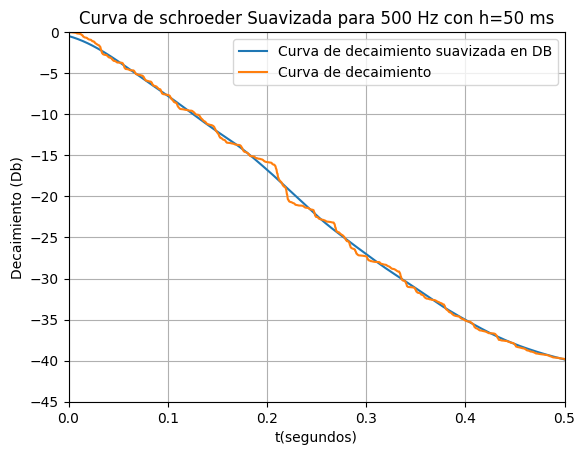

In [ ]:
directorio = "D:\Room Acoustics Project"
fs, audio = wavfile.read(os.path.join(directorio, "Processed_G02.wav"))

b, a = design_octave_band_filter(fs, 500)
filtered_audio = signal.lfilter(b, a, audio)

# Calcular energía (cuadrado de la señal filtrada)
energy = filtered_audio ** 2
#print(sum(energy))
# Calcular TR20
schroeder = np.cumsum(energy[::-1])[::-1]  # Integral de Schroeder
schroeder=schroeder/max(schroeder)


plt.plot(np.arange(len(schroeder))/fs,kde_epanechnikov(10*np.log10(schroeder),fs,50),label="Curva de decaimiento suavizada en DB")
plt.plot(np.arange(len(schroeder))/fs,10*np.log10(schroeder),label="Curva de decaimiento")
plt.xlim([0,0.5])
plt.ylim([-45,0])
plt.grid(True)
plt.xlabel("t(segundos)")
plt.ylabel("Decaimiento (Db)")
plt.title("Curva de schroeder Suavizada para 500 Hz con h=50 ms")
plt.legend()
plt.show()

In [14]:
fs = 44100
t = np.arange(0, 2*fs)/fs

SNR=calcular_snr_db(filtered_audio,fs)
# Especificar rangos: [mínimo, máximo] para cada gráfico

print("Analisis de derivada del decaimiento energetico para schroeder sin suavizar")
TR=interactive_schroeder_analysis(10*np.log10(schroeder[0:fs*2]),
    fs,SNR,
    y_range_db=[-70, 5],       # Límites para el gráfico en dB
    y_range_deriv=[-140, 50],   # Límites para la derivada
    Plot=True

)
print("Analisis de derivada del decaimiento energetico para schroeder suavizado")
TR=interactive_schroeder_analysis(kde_epanechnikov(10*np.log10(schroeder[0:fs*2]),fs,50),
    fs,SNR,
    y_range_db=[-70, 5],       # Límites para el gráfico en dB
    y_range_deriv=[-140, 50],   # Límites para la derivada
    Plot=True

)



Analisis de derivada del decaimiento energetico para schroeder sin suavizar
Pendiente Estimada  -93.30241958491635
TR Estimado 0.6430701397340809
Ruido de fondo  41.29677759270412


Analisis de derivada del decaimiento energetico para schroeder suavizado
Pendiente Estimada  -92.49903515127704
TR Estimado 0.6486554146416049
Ruido de fondo  41.29677759270412


## Calculo de t20 para graciones reales

Se estimó con T20 ya que las condiciones del recinto no permitián estimar T30 con fiabilidad para todos los puntos

In [ ]:
archivos = [f for f in os.listdir(directorio) if f.startswith('Processed_G') and f.endswith('.wav')]

# Diccionario para almacenar resultados {archivo: {frecuencia: TR60}}
tr60_por_banda = {}

center_freqs=[500,2000]
for archivo in archivos:
    fs, audio = wavfile.read(os.path.join(directorio, archivo))
    audio = audio.astype(float)
    if len(audio.shape) > 1:  # Convertir a mono si es estéreo
        audio = audio.mean(axis=1)
    
    tr60_por_banda[archivo] = {}
   
    for freq in center_freqs:
        # Diseñar filtro y aplicar
        b, a = design_octave_band_filter(fs, freq)
        filtered_audio = signal.lfilter(b, a, audio)
        
        # Calcular energía (cuadrado de la señal filtrada)
        energy = filtered_audio ** 2
        schroeder = np.cumsum(energy[::-1])[::-1]  # Integral de Schroeder
        #print(sum(energy))
        # Calcular TR20
        
        tr60=compute_t20(schroeder, fs, plot=False)
        
        tr60_por_banda[archivo][freq] = tr60

        print(f"Archivo: {archivo} | Banda: {freq} Hz | TR60: {tr60:.4f} s")


Archivo: Processed_G01.wav | Banda: 500 Hz | TR60: 0.6067 s
Archivo: Processed_G01.wav | Banda: 2000 Hz | TR60: 0.8674 s
Archivo: Processed_G02.wav | Banda: 500 Hz | TR60: 0.6323 s
Archivo: Processed_G02.wav | Banda: 2000 Hz | TR60: 0.8996 s
Archivo: Processed_G03.wav | Banda: 500 Hz | TR60: 0.6321 s
Archivo: Processed_G03.wav | Banda: 2000 Hz | TR60: 0.8826 s
Archivo: Processed_G04.wav | Banda: 500 Hz | TR60: 0.6643 s
Archivo: Processed_G04.wav | Banda: 2000 Hz | TR60: 0.8916 s
Archivo: Processed_G05.wav | Banda: 500 Hz | TR60: 0.6584 s
Archivo: Processed_G05.wav | Banda: 2000 Hz | TR60: 0.8751 s
Archivo: Processed_G06.wav | Banda: 500 Hz | TR60: 0.6089 s
Archivo: Processed_G06.wav | Banda: 2000 Hz | TR60: 0.8878 s
Archivo: Processed_G07.wav | Banda: 500 Hz | TR60: 0.6329 s
Archivo: Processed_G07.wav | Banda: 2000 Hz | TR60: 0.9196 s
Archivo: Processed_G08.wav | Banda: 500 Hz | TR60: 0.6353 s
Archivo: Processed_G08.wav | Banda: 2000 Hz | TR60: 0.9210 s
Archivo: Processed_G09.wav | Ban

Calcúlo con el metodo propuesto

In [ ]:
# Diccionario para almacenar resultados {archivo: {frecuencia: TR60}}
tr60_por_banda_soft = {}

center_freqs=[500,2000]
for archivo in archivos:
    fs, audio = wavfile.read(os.path.join(directorio, archivo))
    audio = audio.astype(float)
    if len(audio.shape) > 1:  # Convertir a mono si es estéreo
        audio = audio.mean(axis=1)
    
    tr60_por_banda_soft[archivo] = {}
   
    for freq in center_freqs:
        # Diseñar filtro y aplicar
        b, a = design_octave_band_filter(fs, freq)
        filtered_audio = signal.lfilter(b, a, audio)
        
        # Calcular energía (cuadrado de la señal filtrada)
        energy = filtered_audio ** 2
        #print(sum(energy))
        # Calcular TR20
        schroeder = np.cumsum(energy[::-1])[::-1]  # Integral de Schroeder
        schroeder=schroeder/max(schroeder)

        schroeder_s=kde_epanechnikov(schroeder,fs,50)
        schroeder_s=schroeder_s/max(schroeder_s)
        SNR=calcular_snr_db(filtered_audio,fs)
        #schroeder_db=10*np.log10(schroeder_s[:2*fs])
        schroeder_db=kde_epanechnikov(10*np.log10(schroeder[:2*fs]),fs,50)
        #print(max(schroeder_db))
        tr60=interactive_schroeder_analysis(schroeder_db, fs,SNR,[-60,0],[-120,20],Plot=False)
        
        tr60_por_banda_soft[archivo][freq] = tr60

        print(f"Archivo: {archivo} | Banda: {freq} Hz | TR60 oringinal: {tr60_por_banda[archivo][freq]:.3f} s")



Pendiente Estimada  -97.7306214676077
TR Estimado 0.613932451252105
Ruido de fondo  50.18520963307591
Archivo: Processed_G01.wav | Banda: 500 Hz | TR60 oringinal: 0.607 s
Pendiente Estimada  -67.31541282455946
TR Estimado 0.891326332000292
Ruido de fondo  47.95924570708066
Archivo: Processed_G01.wav | Banda: 2000 Hz | TR60 oringinal: 0.867 s
Pendiente Estimada  -92.49903515127704
TR Estimado 0.6486554146416049
Ruido de fondo  41.29677759270412
Archivo: Processed_G02.wav | Banda: 500 Hz | TR60 oringinal: 0.632 s
Pendiente Estimada  -65.26219791737086
TR Estimado 0.9193683620028645
Ruido de fondo  42.422454183909586
Archivo: Processed_G02.wav | Banda: 2000 Hz | TR60 oringinal: 0.900 s
Pendiente Estimada  -98.98911252116878
TR Estimado 0.6061272646238648
Ruido de fondo  49.07512917503511
Archivo: Processed_G03.wav | Banda: 500 Hz | TR60 oringinal: 0.632 s
Pendiente Estimada  -65.6567013416358
TR Estimado 0.9138442653065693
Ruido de fondo  47.7395699567476
Archivo: Processed_G03.wav | Band

C:\Users\Usuario\AppData\Local\Temp\ipykernel_27204\2893188191.py:20: MatplotlibDeprecationWarning:

The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.

C:\Users\Usuario\AppData\Local\Temp\ipykernel_27204\2893188191.py:26: MatplotlibDeprecationWarning:

The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.



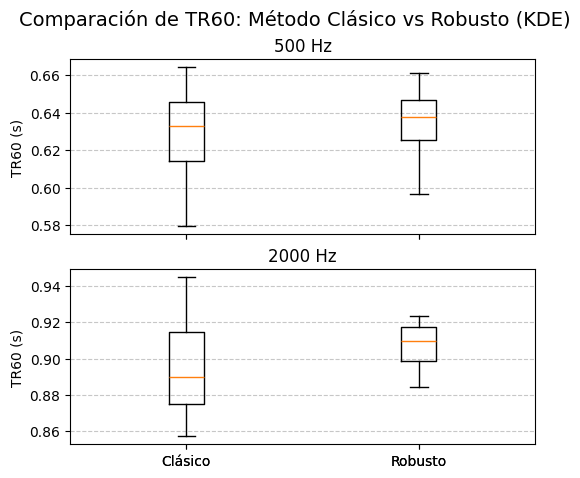

In [15]:

t60Norm={500:[],2000:[]}
t60Soft={500:[],2000:[]}
for data in list(tr60_por_banda.values()):
    # Extraer la frecuencia (2000) y el valor asociado
    
    t60Norm[2000].append(data[2000])
    t60Norm[500].append(data[500])
for data in list(tr60_por_banda_soft.values()):
    # Extraer la frecuencia (2000) y el valor asociado
    
    t60Soft[2000].append(data[2000])
    t60Soft[500].append(data[500])
t60Norm_500 = np.array(t60Norm[500])
t60Soft_500 = np.array(t60Soft[500])
t60Norm_2000 = np.array(t60Norm[2000])
t60Soft_2000 = np.array(t60Soft[2000])
fig, axes = plt.subplots(2, 1, figsize=(6, 5), sharex=True)

# Boxplot para 500 Hz
axes[0].boxplot([t60Norm_500, t60Soft_500], labels=['Clásico', 'Robusto'])
axes[0].set_title('500 Hz')
axes[0].set_ylabel('TR60 (s)')
axes[0].grid(axis='y', linestyle='--', alpha=0.7)

# Boxplot para 2000 Hz
axes[1].boxplot([t60Norm_2000, t60Soft_2000], labels=['Clásico', 'Robusto'])
axes[1].set_title('2000 Hz')
axes[1].set_ylabel('TR60 (s)')
axes[1].grid(axis='y', linestyle='--', alpha=0.7)


fig.suptitle('Comparación de TR60: Método Clásico vs Robusto (KDE)', fontsize=14)
#plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()